# Etude de la répartition public/privé des établissements scolaires français selon l'Indice de Position Sociale

### 1. Importing librairies

In [9]:
import time
startTime = time.time()

import pandas as pd
import scipy
from scipy.stats import skew
import plotly.express as px
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import seaborn as sns
import plotly
import plotly.graph_objects as go
import plotly.io as pio
from tabulate import tabulate
import os

### 2. Creating the relevant folders and paths

In [4]:
# Defining current folder as our main directory
dirname = os.getcwd()

# location folders variables
data_in = dirname + "\\da_data_raw\\" #raw data
data_out = dirname + "\\da_data_workfiles\\" #clean data
graph_out = dirname + "\\graphs\\" #graphs
html_graph_out = "C:\\Users\\33671\\Documents\\my-website\\html5up-massively\\images\\graphs\\" #graphs to be used for html report

# Checking if data_in path is not present, then create it
if not os.path.exists(data_in):
    os.makedirs(data_in)
    print(f"Directory Created: {data_in}")
else: 
    print(f"Already existing directory: {data_in}")
    
# Checking if data_out path is not present then create it
if not os.path.exists(data_out):
    os.makedirs(data_out)
    print(f"Directory Created: {data_out}")
else:
    print(f"Already existing directory: {data_out}")
    
# Checking if data_out path is not present then create it
if not os.path.exists(graph_out):
    os.makedirs(graph_out)
    print(f"Directory Created: {graph_out}")
else:
    print(f"Already existing directory: {graph_out}")    

# Printing main directories we will work with
print(f"\nMain directory: {dirname}")
print(f"Raw data folder: {data_in}")
print(f"Clean data folder: {data_out}")

Already existing directory: c:\Users\33671\Documents\Python\IPS\da_data_raw\
Already existing directory: c:\Users\33671\Documents\Python\IPS\da_data_workfiles\
Already existing directory: c:\Users\33671\Documents\Python\IPS\graphs\

Main directory: c:\Users\33671\Documents\Python\IPS
Raw data folder: c:\Users\33671\Documents\Python\IPS\da_data_raw\
Clean data folder: c:\Users\33671\Documents\Python\IPS\da_data_workfiles\


### 3. Importing master file

In [5]:
df = pd.read_csv(f"{data_out}\df_master.csv")

C:\Users\33671\AppData\Local\Temp\ipykernel_6708\1264866014.py:1: DtypeWarning: Columns (5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(f"{data_out}\df_master.csv")


In [6]:
df.head()

,uai,nom_etablissment,type_etablissement,code_academie,academie,code_departement,departement,code_insee_commune,code_region,region,...,position,date_ouverture,libgeo,zonage_rur,zonage_rur_lib,zone_rur_simple,rentree_scolaireright,rep,rep_plus,nombre_total_eleves
0,0640891w,ecole elementaire,ecole,4.0,bordeaux,64,pyrenees-atlantiques,64253,75.0,nouvelle-aquitaine,...,"{'lon': -0.7540354152972131, 'lat': 43.2865348...",1970-02-05,gurs,2.0,rural autonome peu dense,rural,2019.0,0.0,0.0,31.0
1,0640891w,ecole elementaire,ecole,4.0,bordeaux,64,pyrenees-atlantiques,64253,75.0,nouvelle-aquitaine,...,"{'lon': -0.7540354152972131, 'lat': 43.2865348...",1970-02-05,gurs,2.0,rural autonome peu dense,rural,2020.0,0.0,0.0,27.0
2,0640891w,ecole elementaire,ecole,4.0,bordeaux,64,pyrenees-atlantiques,64253,75.0,nouvelle-aquitaine,...,"{'lon': -0.7540354152972131, 'lat': 43.2865348...",1970-02-05,gurs,2.0,rural autonome peu dense,rural,2021.0,0.0,0.0,31.0
3,0640960w,ecole primaire publique,ecole,4.0,bordeaux,64,pyrenees-atlantiques,64359,75.0,nouvelle-aquitaine,...,"{'lon': -0.6564426369228661, 'lat': 43.2854034...",1970-02-04,lucq-de-béarn,2.0,rural autonome peu dense,rural,2019.0,0.0,0.0,63.0
4,0640960w,ecole primaire publique,ecole,4.0,bordeaux,64,pyrenees-atlantiques,64359,75.0,nouvelle-aquitaine,...,"{'lon': -0.6564426369228661, 'lat': 43.2854034...",1970-02-04,lucq-de-béarn,2.0,rural autonome peu dense,rural,2020.0,0.0,0.0,65.0


### 4. IPS violin distribution

In [7]:
#pio.renderers.default = "notebook_connected"

fig = go.Figure()

# Trace public school 
fig.add_trace(go.Violin(x=df['type_etablissement'][df['secteur'] == 'public'],
                        y=df['ips'][df['secteur'] == 'public'],
                        legendgroup='public', 
                        scalegroup='public', 
                        name='public',
                        line_color='#E66360',
                        points=False,
                        )
)
# Trace private school
fig.add_trace(go.Violin(x=df['type_etablissement'][df['secteur'] == 'prive'],
                        y=df['ips'][df['secteur'] == 'prive'],
                        legendgroup='privé', 
                        scalegroup='privé', 
                        name='privé',
                        line_color='#8BC6FC',
                        points=False
                        )
)

# Show boxes
fig.update_traces(box_visible=True, meanline_visible=True)



# Customize layout (no title)
fig.update_layout(
    violinmode='group',
    width=900, 
    height=600,
    title="",
    xaxis_title="",
    yaxis_title="Indice de position sociale",
    margin=dict(l=90,
                r=50, 
                b=50, 
                t=40, 
                pad=4),
    legend=dict(orientation="h", 
                yanchor="bottom",
                y=1.01, 
                xanchor="left")
)

# Add source annotation     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr"), 
    showarrow=False, 
    x = -0.06, 
    y = -0.1, 
    xref='paper', 
    yref='paper', 
    xanchor='left', 
    yanchor='bottom', 
    xshift=-1, 
    yshift=-5, 
    font=dict(size=8, color="grey"), 
    align="left"
    )

# Add copyright annotation
fig.add_annotation(
    text = (f"@crish1eev1"), 
    showarrow=False, 
    x = 0.92, 
    y = -0.1, 
    xref='paper', 
    yref='paper' , 
    xanchor='left', 
    yanchor='bottom', 
    xshift=-1, 
    yshift=-5, 
    font=dict(size=10, color="grey"), 
    align="left"
)


# Save no-title file (used in report)      
file_name = 'violin-distribution-prive-public-selon-ips_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'violin-distribution-prive-public-selon-ips_no-title' + ".html"
plotly.offline.plot(fig, filename=graph_out + file_name)

file_name = 'violin-distribution-prive-public-selon-ips_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)


# Add title and change margins
fig.update_layout(title="Répartition des écoles selon l\'indice de protection sociale ",
                  margin=dict(l=90, r=50, b=50, t=70, pad=4),
)

# Save title file  
file_name = 'violin-distribution-prive-public-selon-ips' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'violin-distribution-prive-public-selon-ips' + ".html"
plotly.offline.plot(fig, filename=graph_out + file_name)

file_name = 'violin-distribution-prive-public-selon-ips' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)



# Show fig
fig.show()

### 5. IPS Central tendency stats

In [23]:
#common measures of central tendency for public elementary school
df[(df['type_etablissement']=="ecole") & (df['secteur']=="public")]['ips'].describe()

count    82615.000000
mean       101.215524
std         15.707617
min         49.600000
25%         91.500000
50%        101.900000
75%        111.600000
max        155.600000
Name: ips, dtype: float64

In [19]:
skew(df[(df['type_etablissement']=="ecole") & (df['secteur']=="public")]['ips'])

-0.1445199332261252

In [11]:
#common measures of central tendency for private elementary school
df[(df['type_etablissement']=="ecole") & (df['secteur']=="prive")]['ips'].describe()

count    13616.000000
mean       112.217546
std         15.048158
min         56.800000
25%        101.200000
50%        110.400000
75%        121.800000
max        155.400000
Name: ips, dtype: float64

In [28]:
skew(df[(df['type_etablissement']=="ecole") & (df['secteur']=="prive")]['ips'])

0.37499904824376534

In [12]:
#common measures of central tendency for public college school
df[(df['type_etablissement']=="college") & (df['secteur']=="public")]['ips'].describe()

count    5305.000000
mean       99.982601
std        15.290075
min        51.300000
25%        90.600000
50%       100.500000
75%       109.500000
max       157.600000
Name: ips, dtype: float64

In [34]:
skew(df[(df['type_etablissement']=="college") & (df['secteur']=="public")]['ips'], nan_policy='omit')

-0.03843528763203824

In [13]:
#common measures of central tendency for private college school
df[(df['type_etablissement']=="college") & (df['secteur']=="prive")]['ips'].describe()

count    1659.000000
mean      114.221700
std        16.038041
min        66.000000
25%       102.600000
50%       112.800000
75%       125.200000
max       154.900000
Name: ips, dtype: float64

In [35]:
skew(df[(df['type_etablissement']=="college") & (df['secteur']=="prive")]['ips'], nan_policy='omit')

0.23817857436059942

### 6. Histogram with 7 IPS bins

Bins creation

In [10]:
#bin values into discrete intervals
bins = [0, 90, 100, 110, 120, 130, 140, 999]
labels = ["Moins de 90", "90 à 100", "100 à 110", "110 à 120", "120 à 130", "130 à 140", "Plus de 140"]
groups_ecole = df[df['type_etablissement']=="ecole"].groupby(['secteur', pd.cut(df.ips, 
                                                            bins=bins, 
                                                            right=False, 
                                                            include_lowest=False, 
                                                            labels=labels)])
groups_college = df[df['type_etablissement']=="college"].groupby(['secteur', pd.cut(df.ips, 
                                                                bins=bins, 
                                                                right=False, 
                                                                include_lowest=False, 
                                                                labels=labels)])

#display groupedby bin count
ips_ecole_split_absolute = groups_ecole.size().unstack()
ips_college_split_absolute = groups_college.size().unstack()

#transpose tables
ips_ecole_split = ips_ecole_split_absolute.T
ips_college_split = ips_college_split_absolute.T

#normalize results in %
ips_ecole_split = ips_ecole_split.div(ips_ecole_split.sum(axis=1), axis=0)
ips_college_split = ips_college_split.div(ips_college_split.sum(axis=1), axis=0)

#round tables to 2 decimals
ips_ecole_split = ips_ecole_split.round(decimals=3)
ips_college_split = ips_college_split.round(decimals=3)

In [11]:
# In absolute numbers
print(tabulate(ips_ecole_split_absolute, headers=labels, tablefmt="github"))
print("\n")
print(tabulate(ips_college_split_absolute, headers=labels, tablefmt="github"))

|        |   Moins de 90 |   90 à 100 |   100 à 110 |   110 à 120 |   120 à 130 |   130 à 140 |   Plus de 140 |
|--------|---------------|------------|-------------|-------------|-------------|-------------|---------------|
| prive  |           604 |       2289 |        3767 |        3118 |        1958 |        1161 |           719 |
| public |         18201 |      18820 |       21824 |       14778 |        6397 |        2121 |           474 |


|        |   Moins de 90 |   90 à 100 |   100 à 110 |   110 à 120 |   120 à 130 |   130 à 140 |   Plus de 140 |
|--------|---------------|------------|-------------|-------------|-------------|-------------|---------------|
| prive  |            76 |        245 |         396 |         383 |         270 |         169 |           120 |
| public |          1268 |       1291 |        1468 |         812 |         325 |         105 |            36 |


In [12]:
# plt.style.use("default") 
# mpl.rcParams.keys()

Graph customization

In [13]:
# Reset to default plot style just in case
plt.style.use("default") 

# see https://matplotlib.org/stable/tutorials/introductory/customizing.html
# find default figure with mpl.rcParams.keys()

# Style spines
mpl.rcParams['axes.linewidth'] = 0.2  # Spine edge line width (default = 0.8)
mpl.rcParams['axes.spines.top'] = False # Top spine show (default = True)
mpl.rcParams['axes.spines.left'] = True # Left spine show (default = True)
mpl.rcParams['axes.spines.right'] = False # Right spine show (default = True)
mpl.rcParams['axes.spines.bottom'] = True # Bottom spine show (default = True)

# Grid style
mpl.rcParams['axes.grid'] = True # Adding grid (default = False)
mpl.rcParams['axes.grid.axis'] = 'y' # Grid on x or y or both axis (default = 'both')
mpl.rcParams['grid.linewidth'] = 0.2 # Grid line width (default = 0.8)
mpl.rcParams['grid.color'] = '#DBDBD0' # Grid line color (default = #b0b0b0)
mpl.rcParams['axes.axisbelow'] = 'line' # Draw grid line below patches (True), above all (False) or above patches but below lines ('line') (default = 'line')

# Figure size
mpl.rcParams['figure.figsize'] = 8, 4.5  # Figure size in inches (default = 6.4, 4.8)
mpl.rcParams['figure.dpi'] = 100 # Figure dots per inch (default = 100)

# Set spacing for figure (All dimensions are a fraction of the figure width and height)
mpl.rcParams['figure.subplot.left'] = 0.125 # Left (default = 0.125)
mpl.rcParams['figure.subplot.right'] = 0.90 # Right (default = 0.9)
mpl.rcParams['figure.subplot.bottom'] = 0.11 # Bottom (default = 0.11)
mpl.rcParams['figure.subplot.top'] = 0.88 # Top (default = 0.88)

# Legend Styling
mpl.rcParams['legend.frameon'] = False # If True, draw the legend on a background patch (default = True)
mpl.rcParams['legend.framealpha'] = 0.8 # Legend patch transparency (default = 0.8)
mpl.rcParams['legend.fontsize'] = 'small' # Legend font size (default = medium)
mpl.rcParams["legend.loc"] = 'best'

# Properties for saving the figure. Ensure a high DPI when saving so we have a good resolution.
mpl.rcParams['savefig.dpi'] = 300
mpl.rcParams['savefig.bbox'] = 'tight'
#mpl.rcParams['savefig.pad_inches'] = 0.2

# Title styling
mpl.rcParams['axes.titlelocation'] = 'left' # Alignment of the title (default = center)
mpl.rcParams['axes.titlepad'] = 20 # Pad between axes and title (default = 6.0)
mpl.rcParams['axes.titlesize'] = 'medium' # (default = large)
mpl.rcParams['axes.titleweight'] = 'bold' # (default = normal)

# Setting font sizes and spacing
mpl.rcParams['axes.labelsize'] = 'small'
mpl.rcParams['xtick.labelsize'] = 'x-small'
mpl.rcParams['ytick.labelsize'] = 'x-small'
mpl.rcParams['font.size'] = 10
mpl.rcParams['xtick.major.pad'] = 3.5
mpl.rcParams['ytick.major.pad'] = 3.5

Primary Schools

C:\Users\33671\AppData\Local\Temp\ipykernel_10016\2777674762.py:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



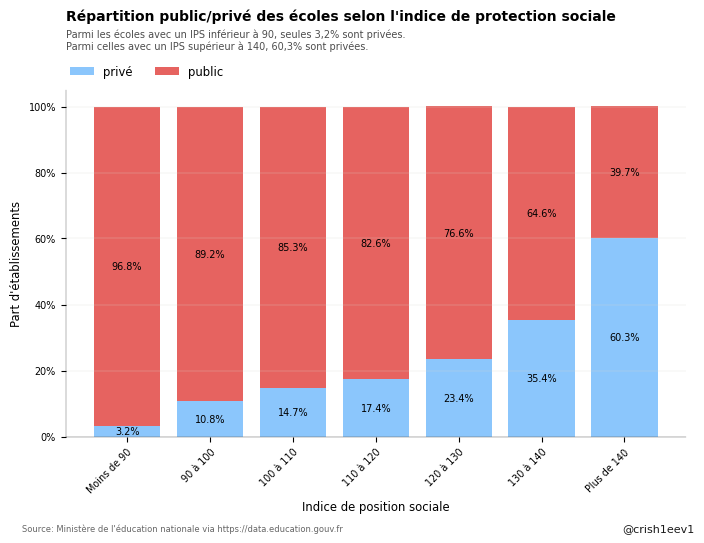

In [14]:
fig, ax = plt.subplots()

# bars
bar1 = ax.bar(ips_ecole_split.index, ips_ecole_split['prive'], label='privé', color='#8BC6FC')
bar2 = ax.bar(ips_ecole_split.index, ips_ecole_split['public'], label='public', bottom=ips_ecole_split['prive'], color='#E66360')

# legend and labels
ax.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left", ncol=2, borderaxespad=0) #https://stackoverflow.com/questions/4700614/how-to-put-the-legend-outside-the-plot/43439132#43439132
ax.set_xlabel("Indice de position sociale")
ax.set_ylabel("Part d'établissements")

# ticklabels orientation
ax.set_xticklabels(
    labels=ips_ecole_split.index,
    rotation=45, 
    ha="right",  
    rotation_mode="anchor")

# format yticks in %
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1.0))

# add figures in % within the bars
label_bar1 = ((ips_ecole_split['prive']*100).round(2).astype(str)) + '%'
label_bar2 = ((ips_ecole_split['public']*100).round(2).astype(str)) + '%'
ax.bar_label(bar1, padding=0, label_type='center', labels=label_bar1, fontsize=7)
ax.bar_label(bar2, padding=0, label_type='center', labels=label_bar2, fontsize=7)

# Source text
ax.text(x=.07, y=-0.1, 
        s="Source: Ministère de l'éducation nationale via https://data.education.gouv.fr", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=6, 
        alpha=.6)

# copyright text
ax.text(x=.82, y=-0.1, 
        s="@crish1eev1", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=8, 
        alpha=.9)

# Save no-title file (used in report)
file_name = 'ecole_repartition-prive-public-selon-ips_no-title' + ".png"
plt.savefig(graph_out + file_name)

file_name = 'ecole_repartition-prive-public-selon-ips_no-title' + ".png"
plt.savefig(html_graph_out + file_name)

# # Avoid display with close method
# plt.close(fig)

# Subtitle
ax.text(x=.125, y=.97, 
        s="Parmi les écoles avec un IPS inférieur à 90, seules 3,2% sont privées.\nParmi celles avec un IPS supérieur à 140, 60,3% sont privées.", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=7, 
        alpha=.7)

# Title
ax.set_title('Répartition public/privé des écoles selon l\'indice de protection sociale', pad=50)

# Save file with title
file_name = 'ecole_repartition-prive-public-selon-ips' + ".png"
plt.savefig(graph_out + file_name)

file_name = 'ecole_repartition-prive-public-selon-ips' + ".png"
plt.savefig(html_graph_out + file_name)

Colleges

C:\Users\33671\AppData\Local\Temp\ipykernel_10016\2549866410.py:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



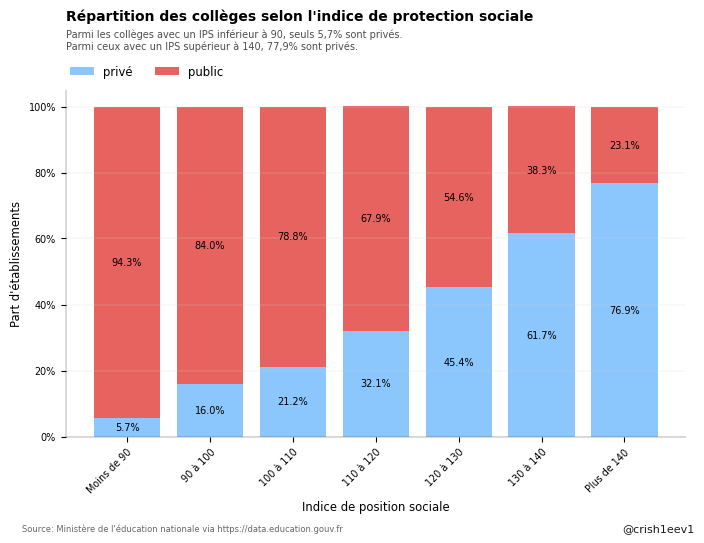

In [15]:
fig, ax = plt.subplots()

# bars
bar1 = ax.bar(ips_college_split.index, ips_college_split['prive'], label='privé', color='#8BC6FC')
bar2 = ax.bar(ips_college_split.index, ips_college_split['public'], label='public', bottom=ips_college_split['prive'], color='#E66360')

# legend and labels
ax.legend(bbox_to_anchor=(0, 1.02, 1, 0.2), loc="lower left", ncol=2, borderaxespad=0) #https://stackoverflow.com/questions/4700614/how-to-put-the-legend-outside-the-plot/43439132#43439132
ax.set_xlabel("Indice de position sociale")
ax.set_ylabel("Part d'établissements")

# ticklabels orientation
ax.set_xticklabels(
    labels=ips_college_split.index,
    rotation=45, 
    ha="right",  
    rotation_mode="anchor")

# format yticks in %
plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1.0))

# add figures in % within the bars
label_bar1 = ((ips_college_split['prive']*100).round(2).astype(str)) + '%'
label_bar2 = ((ips_college_split['public']*100).round(2).astype(str)) + '%'
ax.bar_label(bar1, padding=0, label_type='center', labels=label_bar1, fontsize=7)
ax.bar_label(bar2, padding=0, label_type='center', labels=label_bar2, fontsize=7)

# Source text
ax.text(x=.07, y=-0.1, 
        s="Source: Ministère de l'éducation nationale via https://data.education.gouv.fr", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=6, 
        alpha=.6)

# copyright text
ax.text(x=.82, y=-0.1, 
        s="@crish1eev1", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=8, 
        alpha=.9)

# Save no-title file (used in report)
file_name = 'college_repartition-prive-public-selon-ips_no-title' + ".png"
plt.savefig(graph_out + file_name)

file_name = 'college_repartition-prive-public-selon-ips_no-title' + ".png"
plt.savefig(html_graph_out + file_name)

# add title
ax.set_title('Répartition des collèges selon l\'indice de protection sociale', pad=50)

# add subtitle
ax.text(x=.125, y=.97, 
        s="Parmi les collèges avec un IPS inférieur à 90, seuls 5,7% sont privés.\nParmi ceux avec un IPS supérieur à 140, 77,9% sont privés.", 
        transform=fig.transFigure, 
        ha='left', 
        fontsize=7, 
        alpha=.7)

# Save file with title
file_name = 'college_repartition-prive-public-selon-ips' + ".png"
plt.savefig(graph_out + file_name)

file_name = 'college_repartition-prive-public-selon-ips' + ".png"
plt.savefig(html_graph_out + file_name)

### 7. IPS and Geolocation 

Ecoles (png version used in report)

In [16]:
#https://plotly.com/python/reference/scattermapbox/

fig = px.scatter_mapbox(df[(df["type_etablissement"] == 'ecole') & (df["nombre_total_eleves"] > 0)], 
                     lat='latitude', lon='longitude', 
                     hover_name="nom_etablissment",
                     hover_data=['secteur', 'ips', 'type_etablissement'],
                     size='nombre_total_eleves',
                     size_max= 3,
                     opacity  = 0.7,
                     center = {'lat': 46.5, 'lon': 2.6},
                     color = 'secteur',
                     color_discrete_sequence = ['#E66360', '#8BC6FC'],
                     zoom = 4.5,
                     mapbox_style = 'open-street-map',
                     width=800,
                     )

#fig.update_traces(marker_size=3, selector=dict(type='scattermapbox'))

fig.update_layout(
    margin={"r":20, "t":20, "l":20, "b": 20},
    #hovermode="x",
    )


file_name = 'geolocation-ecole-prive-public-selon-ips_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'geolocation-ecole-prive-public-selon-ips_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

Ecole (html version used when clicked)

In [17]:
fig = px.scatter_mapbox(df[(df["type_etablissement"] == 'ecole') & (df["nombre_total_eleves"] > 0)], 
                     lat='latitude', lon='longitude', 
                     hover_name="nom_etablissment",
                     hover_data=['secteur', 'ips', 'type_etablissement'],
                     size='nombre_total_eleves',
                     size_max= 3.5,
                     opacity  = 0.6,
                     center = {'lat': 46.5, 'lon': 2.6},
                     color = 'secteur',
                     color_discrete_sequence = ['#E66360', '#8BC6FC'],
                     zoom = 4.5,
                     mapbox_style = 'open-street-map',
                     #title= "Répartition géographique des écoles primaires françaises"
                     #width=800,
                     )

#fig.update_traces(marker_size=4, selector=dict(type='scattermapbox'))

fig.update_layout(margin={"r":30, "t":30, "l":30, "b": 30})

file_name = 'geolocation-ecole-prive-public-selon-ips' + ".html"
plotly.offline.plot(fig, filename=graph_out + file_name)
plotly.offline.plot(fig, filename=html_graph_out + file_name)

'C:\\Users\\33671\\Documents\\my-website\\html5up-massively\\images\\graphs\\geolocation-ecole-prive-public-selon-ips.html'

Collèges (png version used in report)

In [20]:
fig = px.scatter_mapbox(df[df["type_etablissement"] == 'college'], 
                     lat='latitude', lon='longitude', 
                     hover_name="nom_etablissment",
                     hover_data=['secteur', 'ips', 'dnb_taux_de_reussite_2021', 'type_etablissement'],
                     opacity  = 0.7,
                     center = {'lat': 46.5, 'lon': 2.6},
                     color = 'secteur',
                     color_discrete_sequence = ['#E66360', '#8BC6FC'],
                     zoom = 4.5,
                     mapbox_style = 'open-street-map',
                     width=800,
                     )

fig.update_traces(marker_size=5, selector=dict(type='scattermapbox'))

fig.update_layout(margin={"r":20, "t":20, "l":20, "b": 20})

file_name = 'geolocation-college-prive-public-selon-ips_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'geolocation-college-prive-public-selon-ips_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

College (html version used when clicked)

In [23]:
fig = px.scatter_mapbox(df[df["type_etablissement"] == 'college'], 
                     lat='latitude', lon='longitude', 
                     hover_name="nom_etablissment",
                     hover_data=['secteur', 'ips', 'dnb_taux_de_reussite_2021', 'type_etablissement'],
                     opacity  = 0.6,
                     center = {'lat': 46.5, 'lon': 2.6},
                     color = 'secteur',
                     color_discrete_sequence = ['#E66360', '#8BC6FC'],
                     zoom = 4.5,
                     mapbox_style = 'open-street-map',
                     #title= "Répartition géographique des collèges français",
                     #width=800,
                     )

fig.update_traces(marker_size=4, selector=dict(type='scattermapbox'))

fig.update_layout(margin={"r":30, "t":30, "l":30, "b": 30})


file_name = 'geolocation-college-prive-public-selon-ips' + ".html"
plotly.offline.plot(fig, filename=graph_out + file_name)
plotly.offline.plot(fig, filename=html_graph_out + file_name)

'C:\\Users\\33671\\Documents\\my-website\\html5up-massively\\images\\graphs\\geolocation-college-prive-public-selon-ips.html'

### 8. IPS and Regions

Creating a dataframe with regional IPS medians

In [20]:
# Empty dataframe
index = ['nouvelle-aquitaine', 'occitanie', 'grand est',
       'auvergne-rhône-alpes', 'bourgogne-franche-comté',
       'pays de la loire', 'ile-de-france', 'normandie',
       'hauts-de-france', "provence-alpes-côte d'azur",
       'centre-val de loire', 'bretagne', 'corse', 'guadeloupe',
       'tom et collectivités territoriales', 'martinique', 'guyane',
       'la réunion', 'mayotte']

columns = ['ecole_median_public', 'ecole_median_prive', 'delta_ecole', 'college_median_public', 'college_median_prive', 'delta_college']

df_ips_central_tendency = pd.DataFrame(data=None, index=index, columns=columns)

# Filling dataframe with regional means
for region in df['region'].unique():
    df_ips_central_tendency.loc[region, 'ecole_median_public'] = df[(df['type_etablissement']=="ecole") & (df['secteur']=="public") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency.loc[region, 'ecole_median_prive'] = df[(df['type_etablissement']=="ecole") & (df['secteur']=="prive") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency.loc[region, 'college_median_public'] = df[(df['type_etablissement']=="college") & (df['secteur']=="public") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency.loc[region, 'college_median_prive'] = df[(df['type_etablissement']=="college") & (df['secteur']=="prive") & (df['region']==region)]['ips'].median()
    
# Filling delta columns
df_ips_central_tendency['delta_ecole'] = df_ips_central_tendency['ecole_median_prive'] - df_ips_central_tendency['ecole_median_public']
df_ips_central_tendency['delta_college'] = df_ips_central_tendency['college_median_prive'] - df_ips_central_tendency['college_median_public']

# Removing last row
df_ips_central_tendency = df_ips_central_tendency.head(-1)

# Converting to floats
df_ips_central_tendency = df_ips_central_tendency.convert_dtypes()

# Rounding
df_ips_central_tendency = df_ips_central_tendency.round(decimals=2)


df_ips_central_tendency.fillna(0, inplace=True)

df_ips_central_tendency.sort_values(by='delta_ecole', ascending=False, inplace=True)

df_ips_central_tendency


,ecole_median_public,ecole_median_prive,delta_ecole,college_median_public,college_median_prive,delta_college
guyane,66.2,108.4,42.2,66.7,108.55,41.85
la réunion,76.05,114.45,38.4,79.9,118.6,38.7
tom et collectivités territoriales,78.1,108.35,30.25,78.6,0.0,0.0
ile-de-france,107.9,137.1,29.2,104.7,133.5,28.8
martinique,84.5,112.7,28.2,86.5,113.0,26.5
corse,98.15,122.0,23.85,98.9,119.3,20.4
guadeloupe,83.8,104.8,21.0,87.1,103.9,16.8
hauts-de-france,94.2,112.0,17.8,91.5,108.85,17.35
provence-alpes-côte d'azur,103.5,121.0,17.5,101.1,120.5,19.4
centre-val de loire,101.9,115.1,13.2,100.1,112.85,12.75


In [21]:
list(df_ips_central_tendency.index.values)

['guyane',
 'la réunion',
 'tom et collectivités territoriales',
 'ile-de-france',
 'martinique',
 'corse',
 'guadeloupe',
 'hauts-de-france',
 "provence-alpes-côte d'azur",
 'centre-val de loire',
 'grand est',
 'bourgogne-franche-comté',
 'normandie',
 'nouvelle-aquitaine',
 'occitanie',
 'pays de la loire',
 'auvergne-rhône-alpes',
 'bretagne',
 'mayotte']

In [22]:
print(tabulate(df_ips_central_tendency[['ecole_median_public', 'ecole_median_prive', 'delta_ecole']], headers=['','médiane IPS public', 'médiane IPS privé', 'différence'], tablefmt="github"))

|                                    |   médiane IPS public |   médiane IPS privé |   différence |
|------------------------------------|----------------------|---------------------|--------------|
| guyane                             |                66.2  |              108.4  |        42.2  |
| la réunion                         |                76.05 |              114.45 |        38.4  |
| tom et collectivités territoriales |                78.1  |              108.35 |        30.25 |
| ile-de-france                      |               107.9  |              137.1  |        29.2  |
| martinique                         |                84.5  |              112.7  |        28.2  |
| corse                              |                98.15 |              122    |        23.85 |
| guadeloupe                         |                83.8  |              104.8  |        21    |
| hauts-de-france                    |                94.2  |              112    |        17.8  |
| provence

In [23]:
fig = px.box(df[(df['region'].notnull()) & (df['type_etablissement']=="ecole")], 
             y = 'ips', x = 'region', 
             category_orders={'region': list(df_ips_central_tendency.index.values)},
             color = 'secteur', 
             boxmode = 'overlay', 
             color_discrete_map = {'public': '#E66360', 'prive': '#8BC6FC'}, 
             points=False, 
             width=1300, 
             height=450
             )

fig.update_layout(xaxis={'title': "", 'visible': True, 'showticklabels': True},
                  yaxis_title="Indice de position sociale",
                  #margin={'t': 40, 'b': 0},
                  legend=dict(orientation="h", yanchor="bottom",y=1.01, xanchor="left")
                          )


# HOW TO ADD A FOOTNOTE TO BOTTOM LEFT OF PAGE     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr")
    , showarrow=False
    , x = -0.05
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=8, color="grey")
    , align="left"
    ,)

fig.add_annotation(
    text = (f"@crish1eev1")
    , showarrow=False
    , x = 0.95
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=10, color="grey")
    , align="left"
    ,)

# Saving no-title version (for report)
file_name = 'boxplot-ecole-ips-selon-region_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-ecole-ips-selon-region_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

# Adding title
fig.update_layout(title={'text': 'Répartition des écoles primaires selon IPS par région'},
                  margin={'t': 85}
                  )

# Saving file with title
file_name = 'boxplot-ecole-ips-selon-region' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-ecole-ips-selon-region' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

In [24]:
df_ips_central_tendency.sort_values(by='delta_college', ascending=False, inplace=True)

In [25]:
list(df_ips_central_tendency.index.values)

['guyane',
 'la réunion',
 'ile-de-france',
 'martinique',
 'corse',
 "provence-alpes-côte d'azur",
 'hauts-de-france',
 'guadeloupe',
 'grand est',
 'centre-val de loire',
 'normandie',
 'auvergne-rhône-alpes',
 'occitanie',
 'pays de la loire',
 'nouvelle-aquitaine',
 'bourgogne-franche-comté',
 'bretagne',
 'tom et collectivités territoriales',
 'mayotte']

In [26]:
print(tabulate(df_ips_central_tendency[['college_median_public', 'college_median_prive', 'delta_college']], headers=['','médiane IPS public', 'médiane IPS privé', 'différence'], tablefmt="github"))

|                                    |   médiane IPS public |   médiane IPS privé |   différence |
|------------------------------------|----------------------|---------------------|--------------|
| guyane                             |                66.7  |              108.55 |        41.85 |
| la réunion                         |                79.9  |              118.6  |        38.7  |
| ile-de-france                      |               104.7  |              133.5  |        28.8  |
| martinique                         |                86.5  |              113    |        26.5  |
| corse                              |                98.9  |              119.3  |        20.4  |
| provence-alpes-côte d'azur         |               101.1  |              120.5  |        19.4  |
| hauts-de-france                    |                91.5  |              108.85 |        17.35 |
| guadeloupe                         |                87.1  |              103.9  |        16.8  |
| grand es

In [27]:
fig = px.box(df[(df['region'].notnull()) & (df['type_etablissement']=="college")], 
             y = 'ips', x = 'region', 
             category_orders={'region': list(df_ips_central_tendency.index.values)},
             color = 'secteur', 
             boxmode = 'overlay', 
             color_discrete_map = {'public': '#E66360', 'prive': '#8BC6FC'}, 
             points=False, 
             width=1300, 
             height=450
             )

fig.update_layout(xaxis={'title': "", 'visible': True, 'showticklabels': True},
                  yaxis_title="Indice de position sociale",
                  #margin={'t': 40, 'b': 0},
                  legend=dict(orientation="h", yanchor="bottom",y=1.01, xanchor="left")
                          )


# HOW TO ADD A FOOTNOTE TO BOTTOM LEFT OF PAGE     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr")
    , showarrow=False
    , x = -0.05
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=8, color="grey")
    , align="left"
    ,)

fig.add_annotation(
    text = (f"@crish1eev1")
    , showarrow=False
    , x = 0.95
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=10, color="grey")
    , align="left"
    ,)

# Saving no-title version (for report)
file_name = 'boxplot-college-ips-selon-region_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-college-ips-selon-region_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

# Adding title
fig.update_layout(title={'text': 'Répartition des collèges selon IPS par région'},
                  margin={'t': 85}
                  )


# Saving file with title
file_name = 'boxplot-college-ips-selon-region' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-college-ips-selon-region' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)



fig.show()

Par densité de population

In [28]:
df.groupby(by=['zone_rur_simple', 'secteur']).count()['uai']

zone_rur_simple  secteur
rural            prive       2022
                 public     11331
urbain           prive       4182
                 public     21523
Name: uai, dtype: int64

In [29]:
df[df['academie']=='guadeloupe']['zone_rur_simple'].value_counts()

urbain    182
rural      48
Name: zone_rur_simple, dtype: int64

In [30]:
fig = px.box(df[(df['zone_rur_simple'].notnull()) & (df['ips'].notnull())], 
             y = 'ips', x = 'zone_rur_simple', 
             category_orders={'zone_rur_simple': ['rural', 'urbain']},
             color = 'secteur', 
             boxmode = 'group', 
             color_discrete_map = {'public': '#E66360', 'prive': '#8BC6FC'}, 
             points=False, 
             width=800, 
             height=450
             )

fig.update_layout(xaxis={'title': "", 'visible': True, 'showticklabels': True},
                  yaxis_title="Indice de position sociale",
                  #margin={'t': 40, 'b': 0},
                  legend=dict(orientation="h", yanchor="bottom",y=1.01, xanchor="left")
                          )


# HOW TO ADD A FOOTNOTE TO BOTTOM LEFT OF PAGE     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr")
    , showarrow=False
    , x = -0.05
    , y = -0.20
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=8, color="grey")
    , align="left"
    ,)

fig.add_annotation(
    text = (f"@crish1eev1")
    , showarrow=False
    , x = 0.95
    , y = -0.20
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=10, color="grey")
    , align="left"
    ,)

# Saving no-title version (for report)
file_name = 'boxplot-etablissement-ips-selon-zone-rurale_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissement-ips-selon-zone-rurale_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

# Adding title
fig.update_layout(title={'text': 'Répartition des écoles et collèges selon zone rurale'},
                  margin={'t': 85},
                  )

#Saving file with title
file_name = 'boxplot-etablissement-ips-selon-zone-rurale' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissement-ips-selon-zone-rurale' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

In [31]:
# Empty dataframe
index = ['nouvelle-aquitaine', 'occitanie', 'grand est',
       'auvergne-rhône-alpes', 'bourgogne-franche-comté',
       'pays de la loire', 'ile-de-france', 'normandie',
       'hauts-de-france', "provence-alpes-côte d'azur",
       'centre-val de loire', 'bretagne', 'corse', 'guadeloupe',
       'tom et collectivités territoriales', 'martinique', 'guyane',
       'la réunion', 'mayotte']

columns = ['rural_median_public', 'rural_median_prive', 'delta_rural', 'urbain_median_public', 'urbain_median_prive', 'delta_urbain']

df_ips_central_tendency_rural = pd.DataFrame(data=None, index=index, columns=columns)

# Filling dataframe with regional means
for region in df['region'].unique():
    df_ips_central_tendency_rural.loc[region, 'rural_median_public'] = df[(df['zone_rur_simple']=="rural") & (df['secteur']=="public") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency_rural.loc[region, 'rural_median_prive'] = df[(df['zone_rur_simple']=="rural") & (df['secteur']=="prive") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency_rural.loc[region, 'urbain_median_public'] = df[(df['zone_rur_simple']=="urbain") & (df['secteur']=="public") & (df['region']==region)]['ips'].median()
    df_ips_central_tendency_rural.loc[region, 'urbain_median_prive'] = df[(df['zone_rur_simple']=="urbain") & (df['secteur']=="prive") & (df['region']==region)]['ips'].median()
    
# Filling delta columns
df_ips_central_tendency_rural['delta_rural'] = df_ips_central_tendency_rural['rural_median_prive'] - df_ips_central_tendency_rural['rural_median_public']
df_ips_central_tendency_rural['delta_urbain'] = df_ips_central_tendency_rural['urbain_median_prive'] - df_ips_central_tendency_rural['urbain_median_public']

# Removing last row
df_ips_central_tendency_rural = df_ips_central_tendency_rural.head(-1)

# Converting to floats
df_ips_central_tendency_rural = df_ips_central_tendency_rural.convert_dtypes()

# Rounding
df_ips_central_tendency_rural = df_ips_central_tendency_rural.round(decimals=2)


df_ips_central_tendency_rural.fillna(0, inplace=True)

df_ips_central_tendency_rural.sort_values(by='delta_rural', ascending=False, inplace=True)


In [32]:
list(df_ips_central_tendency_rural.index.values)

['tom et collectivités territoriales',
 'guyane',
 'martinique',
 'hauts-de-france',
 'guadeloupe',
 'la réunion',
 "provence-alpes-côte d'azur",
 'centre-val de loire',
 'pays de la loire',
 'grand est',
 'normandie',
 'nouvelle-aquitaine',
 'bourgogne-franche-comté',
 'corse',
 'ile-de-france',
 'mayotte',
 'occitanie',
 'bretagne',
 'auvergne-rhône-alpes']

In [33]:
fig = px.box(df[(df['region'].notnull()) & (df['zone_rur_simple']=="rural") & (df['ips'].notnull())], 
             y = 'ips', x = 'region', 
             category_orders= {'region': list(df_ips_central_tendency_rural.index.values)},
             color = 'secteur', 
             boxmode = 'overlay', 
             color_discrete_map = {'public': '#E66360', 'prive': '#8BC6FC'}, 
             points=False, 
             width=1300, 
             height=450
             )

fig.update_layout(xaxis={'title': "", 'visible': True, 'showticklabels': True},
                  yaxis_title="Indice de position sociale",
                  #margin={'t': 40, 'b': 0},
                  legend=dict(orientation="h", yanchor="bottom",y=1.01, xanchor="left")
                          )


# HOW TO ADD A FOOTNOTE TO BOTTOM LEFT OF PAGE     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr")
    , showarrow=False
    , x = -0.05
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=8, color="grey")
    , align="left"
    ,)

fig.add_annotation(
    text = (f"@crish1eev1")
    , showarrow=False
    , x = 0.95
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=10, color="grey")
    , align="left"
    ,)

# Saving no-title version (for report)
file_name = 'boxplot-etablissements-rural-ips-selon-region_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissements-rural-ips-selon-region_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

# Adding title
fig.update_layout(title={'text': 'Répartition des écoles et collèges selon IPS par région en zone rurale'},
                  margin={'t': 85}
                  )

# Saving file with title
file_name = 'boxplot-etablissements-rural-ips-selon-region' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissements-rural-ips-selon-region' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

In [34]:
print(tabulate(df_ips_central_tendency_rural[['rural_median_public', 'rural_median_prive', 'delta_rural']], headers=['','médiane IPS public', 'médiane IPS privé', 'différence'], tablefmt="github"))

|                                    |   médiane IPS public |   médiane IPS privé |   différence |
|------------------------------------|----------------------|---------------------|--------------|
| tom et collectivités territoriales |                78.1  |              108.35 |        30.25 |
| guyane                             |                57.7  |               87.9  |        30.2  |
| martinique                         |                86.45 |              103    |        16.55 |
| hauts-de-france                    |                94.3  |              105.5  |        11.2  |
| guadeloupe                         |                85.7  |               95.7  |        10    |
| la réunion                         |                71.3  |               78.1  |         6.8  |
| provence-alpes-côte d'azur         |               105.7  |              112.2  |         6.5  |
| centre-val de loire                |                99.1  |              104.5  |         5.4  |
| pays de 

In [35]:
df_ips_central_tendency_rural.sort_values(by='delta_urbain', ascending=False, inplace=True)

In [36]:
list(df_ips_central_tendency_rural.index.values)

['guyane',
 'la réunion',
 'martinique',
 'ile-de-france',
 'guadeloupe',
 'hauts-de-france',
 "provence-alpes-côte d'azur",
 'corse',
 'grand est',
 'centre-val de loire',
 'normandie',
 'nouvelle-aquitaine',
 'bourgogne-franche-comté',
 'auvergne-rhône-alpes',
 'occitanie',
 'pays de la loire',
 'bretagne',
 'mayotte',
 'tom et collectivités territoriales']

In [37]:
print(tabulate(df_ips_central_tendency_rural[['urbain_median_public', 'urbain_median_prive', 'delta_urbain']], headers=['','médiane IPS public', 'médiane IPS privé', 'différence'], tablefmt="github"))

|                                    |   médiane IPS public |   médiane IPS privé |   différence |
|------------------------------------|----------------------|---------------------|--------------|
| guyane                             |                71.4  |              112.55 |        41.15 |
| la réunion                         |                77.1  |              116.6  |        39.5  |
| martinique                         |                84.25 |              113.05 |        28.8  |
| ile-de-france                      |               107.3  |              135.7  |        28.4  |
| guadeloupe                         |                84.7  |              106.3  |        21.6  |
| hauts-de-france                    |                93    |              112.8  |        19.8  |
| provence-alpes-côte d'azur         |               101.8  |              121.4  |        19.6  |
| corse                              |               102.6  |              122    |        19.4  |
| grand es

In [38]:
fig = px.box(df[(df['region'].notnull()) & (df['zone_rur_simple']=="urbain") & (df['ips'].notnull())], 
             y = 'ips', x = 'region', 
             category_orders= {'region': list(df_ips_central_tendency_rural.index.values)},
             color = 'secteur', 
             boxmode = 'overlay', 
             color_discrete_map = {'public': '#E66360', 'prive': '#8BC6FC'}, 
             points=False, 
             width=1300, 
             height=450
             )

fig.update_layout(xaxis={'title': "", 'visible': True, 'showticklabels': True},
                  yaxis_title="Indice de position sociale",
                  #margin={'t': 40, 'b': 0},
                  legend=dict(orientation="h", yanchor="bottom",y=1.01, xanchor="left")
                          )


# HOW TO ADD A FOOTNOTE TO BOTTOM LEFT OF PAGE     https://medium.com/nerd-for-tech/enriching-data-visualizations-with-annotations-in-plotly-using-python-6127ff6e0f80
fig.add_annotation(
    text = (f"Source: Ministère de l'éducation nationale via https://data.education.gouv.fr")
    , showarrow=False
    , x = -0.05
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=8, color="grey")
    , align="left"
    ,)

fig.add_annotation(
    text = (f"@crish1eev1")
    , showarrow=False
    , x = 0.95
    , y = -0.5
    , xref='paper'
    , yref='paper' 
    , xanchor='left'
    , yanchor='bottom'
    , xshift=-1
    , yshift=-5
    , font=dict(size=10, color="grey")
    , align="left"
    ,)

# Saving no-title version (for report)
file_name = 'boxplot-etablissements-urbain-ips-selon-region_no-title' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissements-urbain-ips-selon-region_no-title' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

# Adding title
fig.update_layout(title={'text': 'Répartition des écoles et collèges selon IPS par région en zone urbaine'},
                  margin={'t': 85}
                  )

# Saving file with title
file_name = 'boxplot-etablissements-urbain-ips-selon-region' + ".png"
fig.write_image(graph_out + file_name)

file_name = 'boxplot-etablissements-urbain-ips-selon-region' + ".html"
plotly.offline.plot(fig, filename=html_graph_out + file_name)

fig.show()

In [39]:
executionTime = (time.time() - startTime)
print('Execution time in seconds: ' + str(executionTime))

Execution time in seconds: 93.35123467445374


- Liste des établissements IPS les plus élevés & moins elevés (géo et liste)
- Proportion privés/publics par région, rural vs urbain
- Réorganiser l'ordre des colonnes sur le master file
- Faire varier la taille des dots par le nombre d'élèves
